# **Projeto Integrador**

### 1. Importando Bibliotecas

In [ ]:
#analise exploratoria
import pandas as pd 
import numpy as np 
#gráficos
import seaborn as sns 
import matplotlib.pyplot as plt 
from statsmodels.graphics.gofplots import qqplot
#categorização
from sklearn.model_selection import train_test_split #separacao de treino, teste e validação 
import scipy #matriz de confusao
from statsmodels.stats.outliers_influence import variance_inflation_factor 
from sklearn.metrics import r2_score, mean_squared_error
#arvore de decisao
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, plot_confusion_matrix, plot_roc_curve
#transformar variaveis categoricas
from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler, OneHotEncoder
#metrica de apuracao
from sklearn import metrics
from sklearn.metrics import accuracy_score, recall_score, precision_score, classification_report

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
#google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### 2. Importando Base:

In [ ]:
df_base = pd.read_csv('/content/drive/MyDrive/DH - DATA SCIENCE/PI/BOOKING_8.csv',sep=',')

### 3. Análise Exploratória e Limpeza dos Dados  

In [ ]:
df_base.head()

,MESREF_NUM,VLR_ENTRADA,VLR_FINANCIADO,DOWN_PAYMENT,RANGE_DOWN_PAYMENT,QTD_PRAZO,QTD_PRAZO_AGRP,MODELO_AGRP,ESTADO_VEICULO,ANO_FABRIC,...,VLR_VEIC,SCORE_PONTOS,max_atraso,FX_MAX_ATRASO,MOB_FINAL_CONTRATO,STATUS_CONTRATO,CONTR_NEW,TIPO_PROD,DELTA_MOB,IDADE_VEIC
0,201804,28650.0,21980.19,0.57,51-60,24,13-24,Etios,N,2019,...,50630.19,995.0,0,0. 00 dpd,21,LIQUIDADO,5318042,CDC,-3,0
1,201804,50557.9,25186.80,0.67,61-80,36,25-36,Corolla,N,2019,...,75744.70,993.0,0,0. 00 dpd,27,LIQUIDADO,5318080,CDC,-9,0
2,201804,21000.0,54979.00,0.28,26-30,36,25-36,Etios,N,2019,...,75979.00,984.0,0,0. 00 dpd,35,LIQUIDADO,5319022,CICLO,-1,0
3,201804,30000.0,25579.99,0.54,51-60,24,13-24,Etios,N,2019,...,55579.99,995.0,2,1. 01-15 dpd,23,LIQUIDADO,5319628,CICLO,-1,0
4,201804,39938.5,46953.10,0.46,41-50,36,25-36,Corolla,N,2018,...,86891.60,976.0,0,0. 00 dpd,35,LIQUIDADO,5319914,CDC,-1,0


In [ ]:
df_base.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 134235 entries, 0 to 134234
Data columns (total 25 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   MESREF_NUM          134235 non-null  int64  
 1   VLR_ENTRADA         134235 non-null  float64
 2   VLR_FINANCIADO      134235 non-null  float64
 3   DOWN_PAYMENT        134235 non-null  float64
 4   RANGE_DOWN_PAYMENT  134235 non-null  object 
 5   QTD_PRAZO           134235 non-null  int64  
 6   QTD_PRAZO_AGRP      134235 non-null  object 
 7   MODELO_AGRP         134235 non-null  object 
 8   ESTADO_VEICULO      134235 non-null  object 
 9   ANO_FABRIC          134235 non-null  int64  
 10  FL_TCM              134235 non-null  int64  
 11  NS_RANGE_REGIAO     134235 non-null  object 
 12  NS_PONTUACAO_CRIVO  134025 non-null  float64
 13  NS_RATING_CRIVO     134235 non-null  object 
 14  GRUPO_LOJAS         134235 non-null  object 
 15  VLR_VEIC            134235 non-nul

In [ ]:
print(df_base.shape)
print("="*20)
print(df_base.isna().sum())
print("="*20)
print(df_base.dtypes)

(134235, 25)
MESREF_NUM              0
VLR_ENTRADA             0
VLR_FINANCIADO          0
DOWN_PAYMENT            0
RANGE_DOWN_PAYMENT      0
QTD_PRAZO               0
QTD_PRAZO_AGRP          0
MODELO_AGRP             0
ESTADO_VEICULO          0
ANO_FABRIC              0
FL_TCM                  0
NS_RANGE_REGIAO         0
NS_PONTUACAO_CRIVO    210
NS_RATING_CRIVO         0
GRUPO_LOJAS             0
VLR_VEIC                0
SCORE_PONTOS          210
max_atraso              0
FX_MAX_ATRASO           0
MOB_FINAL_CONTRATO      0
STATUS_CONTRATO         0
CONTR_NEW               0
TIPO_PROD               0
DELTA_MOB               0
IDADE_VEIC              0
dtype: int64
MESREF_NUM              int64
VLR_ENTRADA           float64
VLR_FINANCIADO        float64
DOWN_PAYMENT          float64
RANGE_DOWN_PAYMENT     object
QTD_PRAZO               int64
QTD_PRAZO_AGRP         object
MODELO_AGRP            object
ESTADO_VEICULO         object
ANO_FABRIC              int64
FL_TCM                  

In [ ]:
df_base['NS_PONTUACAO_CRIVO'].unique()

array([ 995.,  993.,  984.,  976.,  997.,  981.,  998.,  977.,  969.,
        985.,  975.,  967.,  970.,  986.,  994.,  978.,  945.,  988.,
        971.,  982.,  999.,  996.,  962.,  979.,  931.,  989.,  991.,
        992.,  955.,  964.,  983.,  987.,  972.,  965.,  950.,  980.,
        966.,  963.,  973.,  942.,  954.,  990.,  949.,  974.,  936.,
        960.,  953.,  958.,  940.,  959.,  930.,  961.,  939.,  968.,
        921.,  956.,  937.,  944.,  957.,  951.,  938.,  932.,  943.,
        952.,  947.,  891.,  934.,  946.,  923.,  948.,  911.,  904.,
        941.,  927.,  933.,  935.,  928.,  916.,  929.,  914.,  924.,
        920.,  887.,  926.,  897.,  862.,  855.,  919.,  908.,  902.,
        892.,  918.,  867.,  912.,  917.,  922.,  906.,  925.,  910.,
        850.,   nan,  889.,  913., 1000.,  864.,  903.,  877.,  870.,
        874.,  915.,  896.,  909.,  905.,  882.,    0.,  883.,  894.,
        893.,  860.,  888.,  901.,  900.,  895.,  898.,  876.,  879.,
        844.,  885.,

In [ ]:
#excluindo valores nulos
df_base.dropna(inplace=True)
print(df_base.shape)
print("="*20)
print(df_base.isna().sum())

(134025, 25)
MESREF_NUM            0
VLR_ENTRADA           0
VLR_FINANCIADO        0
DOWN_PAYMENT          0
RANGE_DOWN_PAYMENT    0
QTD_PRAZO             0
QTD_PRAZO_AGRP        0
MODELO_AGRP           0
ESTADO_VEICULO        0
ANO_FABRIC            0
FL_TCM                0
NS_RANGE_REGIAO       0
NS_PONTUACAO_CRIVO    0
NS_RATING_CRIVO       0
GRUPO_LOJAS           0
VLR_VEIC              0
SCORE_PONTOS          0
max_atraso            0
FX_MAX_ATRASO         0
MOB_FINAL_CONTRATO    0
STATUS_CONTRATO       0
CONTR_NEW             0
TIPO_PROD             0
DELTA_MOB             0
IDADE_VEIC            0
dtype: int64


In [ ]:
#VERIFICANDO SE HÁ LINHAS DUPLICADAS
df_base.value_counts().shape
#nao há linhas duplicadas


(134025,)

In [ ]:
#verificando diferença entre score x crivo
df_base['DIF_SCORE_CRIVO'] =df_base['SCORE_PONTOS'] - df_base['NS_PONTUACAO_CRIVO']
#nao tem diferença, desconsiderar uma das duas colunas

In [ ]:
df_base.drop(['DIF_SCORE_CRIVO'],axis=1,inplace=True)

In [ ]:
#criando sim ou nao para atraso
df_base.loc[df_base['max_atraso'] >= 1,'JA_ATRASOU_PARCELA'] = 1
df_base.loc[df_base['max_atraso'] < 1,'JA_ATRASOU_PARCELA'] = 0

In [ ]:
df_base['JA_ATRASOU_PARCELA'].value_counts()

0.0    96544
1.0    37481
Name: JA_ATRASOU_PARCELA, dtype: int64

###4. Criando Feature Target

In [ ]:
# Se DELTA_MOB < -1, o pagamento foi antecipado. Se DELTA_MOB >-1 o contrato foi quitado no final do prazo.
df_base.loc[df_base['DELTA_MOB'] < -1,'ANTECIPADO'] = 1
df_base.loc[df_base['DELTA_MOB'] >= -1,'ANTECIPADO'] = 0

In [ ]:
df_base['ANTECIPADO'].value_counts()
#35% nao anteciparam obs: to considerando o -1 como não antecipa

1.0    86799
0.0    47226
Name: ANTECIPADO, dtype: int64

In [ ]:
df_base.head()

,MESREF_NUM,VLR_ENTRADA,VLR_FINANCIADO,DOWN_PAYMENT,RANGE_DOWN_PAYMENT,QTD_PRAZO,QTD_PRAZO_AGRP,MODELO_AGRP,ESTADO_VEICULO,ANO_FABRIC,...,max_atraso,FX_MAX_ATRASO,MOB_FINAL_CONTRATO,STATUS_CONTRATO,CONTR_NEW,TIPO_PROD,DELTA_MOB,IDADE_VEIC,JA_ATRASOU_PARCELA,ANTECIPADO
0,201804,28650.0,21980.19,0.57,51-60,24,13-24,Etios,N,2019,...,0,0. 00 dpd,21,LIQUIDADO,5318042,CDC,-3,0,0.0,1.0
1,201804,50557.9,25186.80,0.67,61-80,36,25-36,Corolla,N,2019,...,0,0. 00 dpd,27,LIQUIDADO,5318080,CDC,-9,0,0.0,1.0
2,201804,21000.0,54979.00,0.28,26-30,36,25-36,Etios,N,2019,...,0,0. 00 dpd,35,LIQUIDADO,5319022,CICLO,-1,0,0.0,0.0
3,201804,30000.0,25579.99,0.54,51-60,24,13-24,Etios,N,2019,...,2,1. 01-15 dpd,23,LIQUIDADO,5319628,CICLO,-1,0,1.0,0.0
4,201804,39938.5,46953.10,0.46,41-50,36,25-36,Corolla,N,2018,...,0,0. 00 dpd,35,LIQUIDADO,5319914,CDC,-1,0,0.0,0.0


### 5. Verificando Outliers

In [ ]:
df_base.describe().T

,count,mean,std,min,25%,50%,75%,max
MESREF_NUM,134025.0,2.018965e+05,86.397641,201804.00,201810.00,201904.00,201911.00,202112.00
VLR_ENTRADA,134025.0,5.160903e+04,37307.618990,0.00,28310.00,44000.00,63000.00,396790.00
VLR_FINANCIADO,134025.0,5.297719e+04,33769.393273,2365.77,31676.50,43559.89,63922.03,519548.86
DOWN_PAYMENT,134025.0,4.825617e-01,0.193959,0.00,0.35,0.50,0.60,0.99
QTD_PRAZO,134025.0,3.021803e+01,11.163851,1.00,24.00,36.00,36.00,60.00
ANO_FABRIC,134025.0,2.018876e+03,1.740136,2008.00,2019.00,2019.00,2020.00,2022.00
FL_TCM,134025.0,5.249767e-01,0.499378,0.00,0.00,1.00,1.00,1.00
NS_PONTUACAO_CRIVO,134025.0,9.825824e+02,17.281495,0.00,977.00,988.00,994.00,1000.00
VLR_VEIC,134025.0,1.045862e+05,53000.052618,4928.10,70663.56,90084.65,118906.56,554028.51
SCORE_PONTOS,134025.0,9.825824e+02,17.281495,0.00,977.00,988.00,994.00,1000.00


MESREF_NUM
---------------
QTD_PRAZO
---------------
ANO_FABRIC
---------------
FL_TCM
---------------
max_atraso
---------------
MOB_FINAL_CONTRATO
---------------
CONTR_NEW
---------------
DELTA_MOB
---------------
IDADE_VEIC
---------------


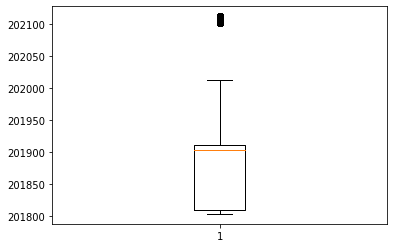

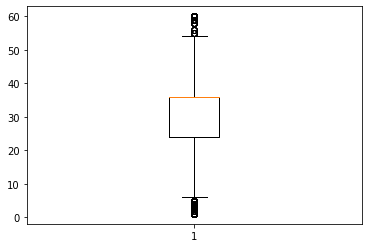

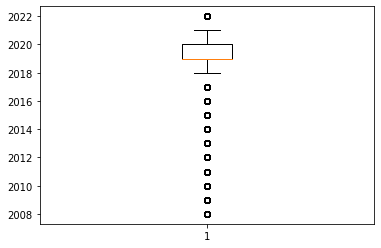

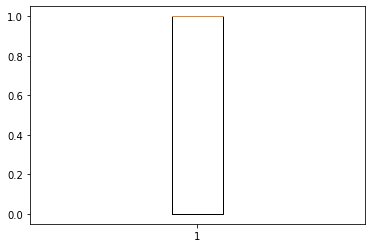

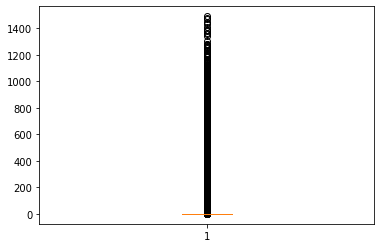

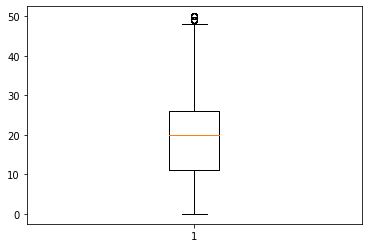

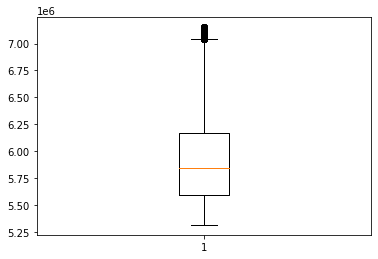

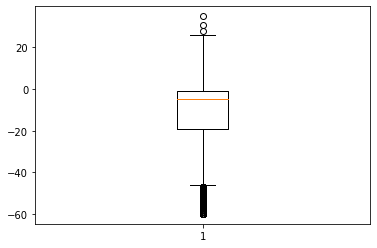

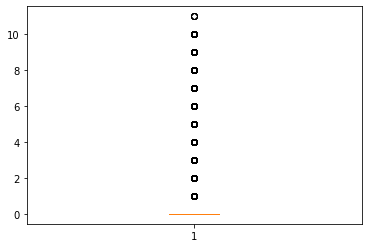

In [ ]:
#verificando outliers
number_cols = df_base.select_dtypes(np.int64,np.float64).columns
for col in number_cols:
  plt.figure()
  plt.boxplot(df_base[col])
  print(df_base[col].name)
  print('---------------')
#ANALISAR COMO VER OUTLIER

###Variação e Correlação

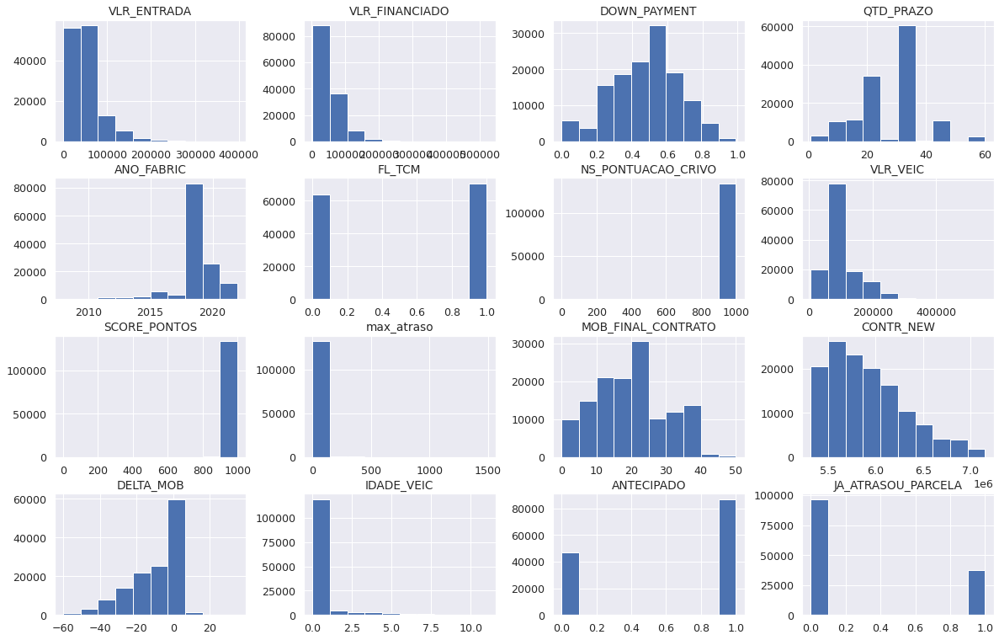

In [ ]:
df_hist = df_base.loc[:,['VLR_ENTRADA','VLR_FINANCIADO','DOWN_PAYMENT','QTD_PRAZO','ANO_FABRIC','FL_TCM','NS_PONTUACAO_CRIVO','VLR_VEIC','SCORE_PONTOS','max_atraso','MOB_FINAL_CONTRATO','CONTR_NEW','DELTA_MOB','IDADE_VEIC','ANTECIPADO','JA_ATRASOU_PARCELA']]
df_hist.hist(figsize=(20,13));

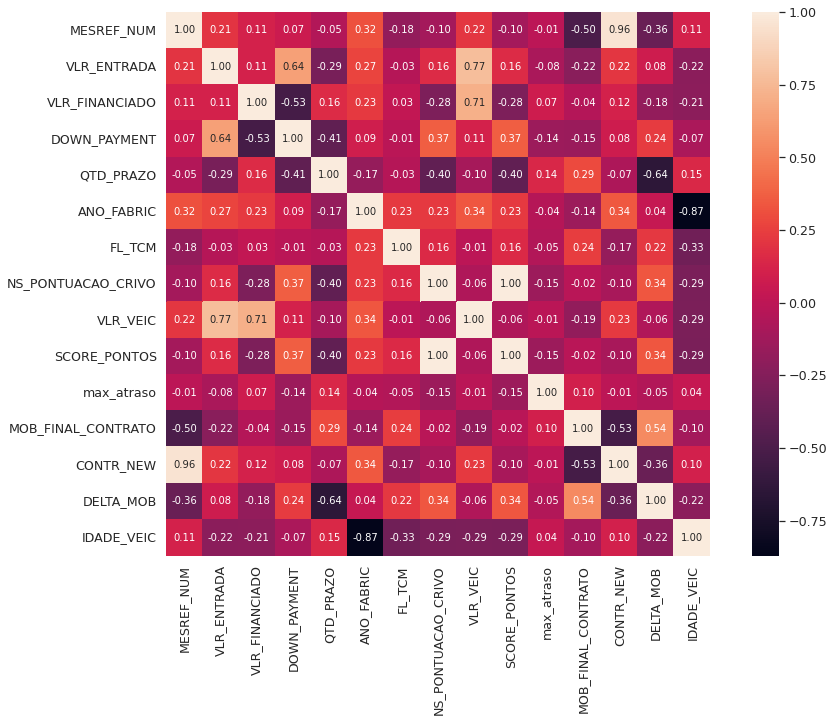

In [ ]:
#correlação
corrmat = df_base.corr()
sns.set(font_scale=1.15)
f, ax = plt.subplots(figsize=(15, 10))
hm = sns.heatmap(corrmat, 
                 cbar=True, # formatando a barra lateral de cores para o heatmap
                 annot=True, 
                 square=True, 
                 fmt='.2f', 
                 annot_kws={'size': 10}, 
                 yticklabels=corrmat.columns, 
                 xticklabels=corrmat.columns)

In [ ]:
df_base['MODELO_AGRP'].unique()

array(['Etios', 'Corolla', 'SW4', 'Hilux', 'OT - Prius', 'OT - Camry',
       'OT - RAV4', 'Outros', 'OT - Lexus', 'OT - Empilhadeira', 'Yaris',
       'OT - Prado', 'Corolla Cross'], dtype=object)

In [ ]:
df_base.drop(['VLR_VEICULO_COMPRA'],axis=1,inplace=True)

Identificados alguns dados os quais podemos excluir e outros para transformar em dummies, conforme planilha https://docs.google.com/spreadsheets/d/1k7XPgPVn-c3Yn84GKI_CKoTlB_i10q7z7ygr71bNdk0/edit#gid=0
      

In [ ]:
#criando base sem colunas
df_base_ajustada = df_base.drop([
              'MESREF_NUM','VLR_ENTRADA','VLR_FINANCIADO','RANGE_DOWN_PAYMENT','QTD_PRAZO','QTD_PRAZO_AGRP','ANO_FABRIC',
              'FL_TCM','NS_PONTUACAO_CRIVO','NS_RATING_CRIVO','GRUPO_LOJAS','max_atraso','FX_MAX_ATRASO','MOB_FINAL_CONTRATO',
              'STATUS_CONTRATO','CONTR_NEW','DELTA_MOB','MODELO_AGRP'],axis=1,inplace=False)

#df_base.drop(['DIF_SCORE_CRIVO'],axis=1,inplace=True)

In [ ]:
df_base_ajustada.head()

,DOWN_PAYMENT,ESTADO_VEICULO,NS_RANGE_REGIAO,VLR_VEIC,SCORE_PONTOS,TIPO_PROD,IDADE_VEIC,JA_ATRASOU_PARCELA,ANTECIPADO
0,0.57,N,Centro-Oeste,50630.19,995.0,CDC,0,0.0,1.0
1,0.67,N,Sudeste,75744.70,993.0,CDC,0,0.0,1.0
2,0.28,N,Centro-Oeste,75979.00,984.0,CICLO,0,0.0,0.0
3,0.54,N,Nordeste,55579.99,995.0,CICLO,0,1.0,0.0
4,0.46,N,Nordeste,86891.60,976.0,CDC,0,0.0,0.0


In [ ]:
df_base_ajustada = pd.get_dummies(df_base_ajustada,drop_first=True)

In [ ]:
df_base_ajustada

,DOWN_PAYMENT,VLR_VEIC,SCORE_PONTOS,IDADE_VEIC,JA_ATRASOU_PARCELA,ANTECIPADO,ESTADO_VEICULO_U,NS_RANGE_REGIAO_Nordeste,NS_RANGE_REGIAO_Norte,NS_RANGE_REGIAO_Sudeste,NS_RANGE_REGIAO_Sul,TIPO_PROD_CICLO
0,0.57,50630.19,995.0,0,0.0,1.0,0,0,0,0,0,0
1,0.67,75744.70,993.0,0,0.0,1.0,0,0,0,1,0,0
2,0.28,75979.00,984.0,0,0.0,0.0,0,0,0,0,0,1
3,0.54,55579.99,995.0,0,1.0,0.0,0,1,0,0,0,1
4,0.46,86891.60,976.0,0,0.0,0.0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
134230,0.45,182023.67,990.0,0,1.0,1.0,0,0,0,0,0,0
134231,0.55,99634.59,977.0,1,0.0,1.0,1,0,0,0,1,0
134232,0.39,177372.47,952.0,0,1.0,1.0,0,1,0,0,0,0
134233,0.64,202576.45,980.0,0,1.0,1.0,0,0,0,1,0,0


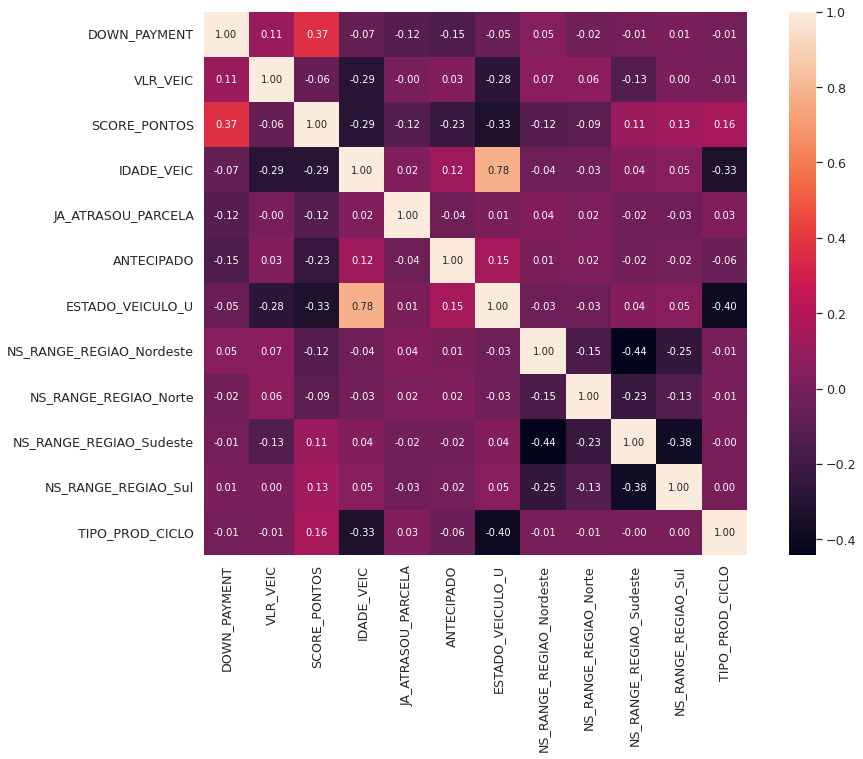

In [ ]:
#correlação dados tratados
corrmat = df_base_ajustada.corr()
sns.set(font_scale=1.15)
f, ax = plt.subplots(figsize=(15, 10))
hm = sns.heatmap(corrmat, 
                 cbar=True, # formatando a barra lateral de cores para o heatmap
                 annot=True, 
                 square=True, 
                 fmt='.2f', 
                 annot_kws={'size': 10}, 
                 yticklabels=corrmat.columns, 
                 xticklabels=corrmat.columns)

### 6. Preparação do Dataset para Modelagem

In [ ]:
df_train, df_test = train_test_split(df_base_ajustada,stratify=df_base_ajustada['ANTECIPADO'],test_size=0.25,random_state=123)

In [ ]:
print(df_train.shape)
print(df_test.shape)


(100518, 12)
(33507, 12)


In [ ]:
X_train, y_train = df_train.drop('ANTECIPADO',axis=1), df_train['ANTECIPADO']
X_test, y_test = df_test.drop('ANTECIPADO',axis=1), df_test['ANTECIPADO']

In [ ]:
print(y_train.value_counts())
print(y_test.value_counts())

1.0    65099
0.0    35419
Name: ANTECIPADO, dtype: int64
1.0    21700
0.0    11807
Name: ANTECIPADO, dtype: int64


In [ ]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)


(100518, 11)
(100518,)
(33507, 11)
(33507,)


### 7. Modelagem - Árvore de Decisão

In [ ]:
parametros = {'criterion': ['gini', 'entropy'],
              'splitter': ['best', 'random'],
              #'min_samples_split': [2, 5, 10],
              #'min_samples_leaf': [1, 5, 10]
              'max_depth':[3,5,10,20]} #testar depois

In [ ]:
from sklearn.model_selection import GridSearchCV

In [ ]:
#Encontrando melhores hiperparâmetros
grid_search = GridSearchCV(estimator=DecisionTreeClassifier(), param_grid=parametros)
grid_search.fit(X_train, y_train)
melhores_parametros = grid_search.best_params_
melhor_resultado = grid_search.best_score_
print(melhores_parametros)
print(melhor_resultado)

{'criterion': 'entropy', 'min_samples_leaf': 10, 'min_samples_split': 5, 'splitter': 'random'}
0.6813008648120358


In [ ]:
clf = DecisionTreeClassifier(criterion='entropy', min_samples_leaf=10,min_samples_split=5, splitter='random')
clf.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', min_samples_leaf=10,
                       min_samples_split=5, splitter='random')

In [ ]:
clf.feature_names_in_

array(['DOWN_PAYMENT', 'VLR_VEIC', 'SCORE_PONTOS', 'IDADE_VEIC',
       'JA_ATRASOU_PARCELA', 'ESTADO_VEICULO_U',
       'NS_RANGE_REGIAO_Nordeste', 'NS_RANGE_REGIAO_Norte',
       'NS_RANGE_REGIAO_Sudeste', 'NS_RANGE_REGIAO_Sul',
       'TIPO_PROD_CICLO'], dtype=object)

In [ ]:
clf.feature_importances_

array([0.38794246, 0.16099294, 0.22579867, 0.01274801, 0.00793446,
       0.09777951, 0.02503389, 0.01216068, 0.03215673, 0.02061164,
       0.01684101])

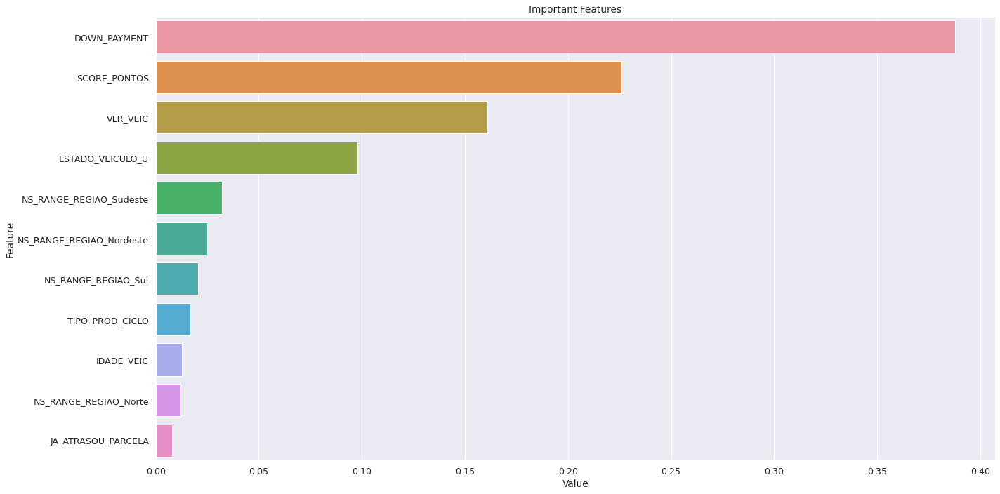

In [ ]:
#Verificando feature importance
cols_model = X_train.columns

feature_imp = pd.DataFrame(sorted(zip(clf.feature_importances_,cols_model)), columns=['Value','Feature'])
plt.figure(figsize=(20, 10))
sns.barplot(x="Value", y="Feature", data=feature_imp.sort_values(by="Value", ascending=False).iloc[:50])
plt.title('Important Features')
plt.tight_layout()
plt.show()

In [ ]:
clf.classes_

array([0., 1.])

In [ ]:
predict_tree_vote_model_train = clf.predict(X_train)
predict_tree_vote_model_test = clf.predict(X_test)

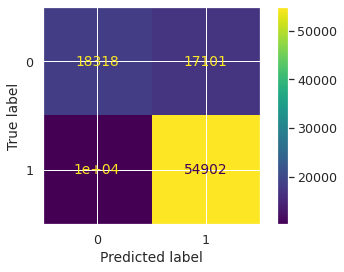

In [ ]:
#Obtendo matriz de confusão para os dados de treino
cm_tree = confusion_matrix(y_train, predict_tree_vote_model_train)

disp = ConfusionMatrixDisplay(confusion_matrix=cm_tree, display_labels=[0,1])
disp.plot() 

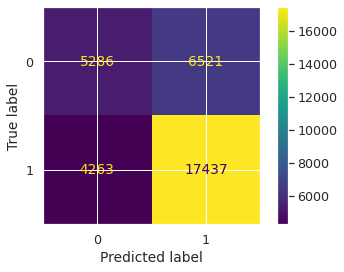

In [ ]:
#Obtendo matriz de confusão para os dados de teste
cm_tree = confusion_matrix(y_test, predict_tree_vote_model_test)

disp = ConfusionMatrixDisplay(confusion_matrix=cm_tree, display_labels=[0,1])
disp.plot() 

In [ ]:
# imprimindo as métricas 
print("Accuracy test:",metrics.accuracy_score(y_test, predict_tree_vote_model_test))
print("Precision test:",metrics.precision_score(y_test, predict_tree_vote_model_test))
print("Recall test:",metrics.recall_score(y_test, predict_tree_vote_model_test))

Accuracy test: 0.6781568030560778
Precision test: 0.7278153435178228
Recall test: 0.8035483870967742


In [ ]:
# imprimindo as métricas 
print("Accuracy train:",metrics.accuracy_score(y_train, predict_tree_vote_model_train))
print("Precision train:",metrics.precision_score(y_train, predict_tree_vote_model_train))
print("Recall train:",metrics.recall_score(y_train, predict_tree_vote_model_train))

Accuracy train: 0.7284267494379116
Precision train: 0.7624960071108148
Recall train: 0.843361649180479


In [ ]:
fig = plt.figure(figsize=(500,200))
_ = tree.plot_tree(clf,
                   feature_names=X_train.columns.to_list(),
                   class_names={0: 'Nao Antecipa', 1: 'Antecipa'},
                   filled=True)